In [4]:
from PIL import Image, ImageEnhance, ImageFilter

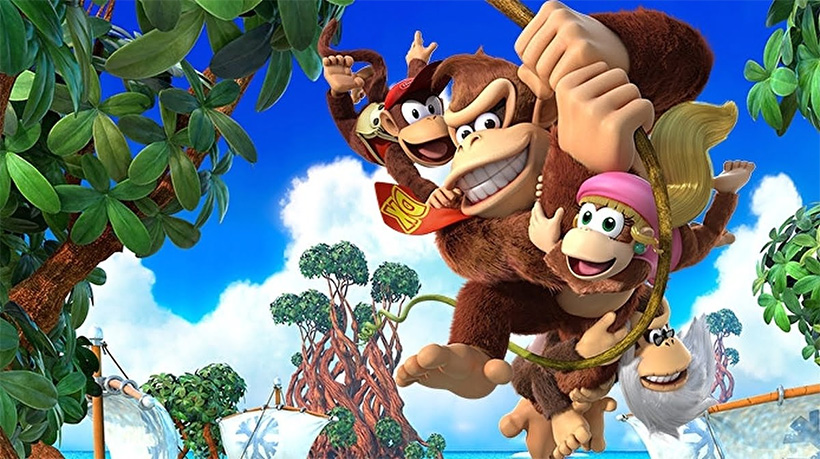

In [5]:
img1 = Image.open("img/donkeykong.jpg")
img1

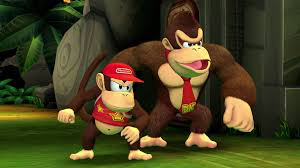

In [6]:
img2 = Image.open('img/donkeykong2.jpeg')
img2

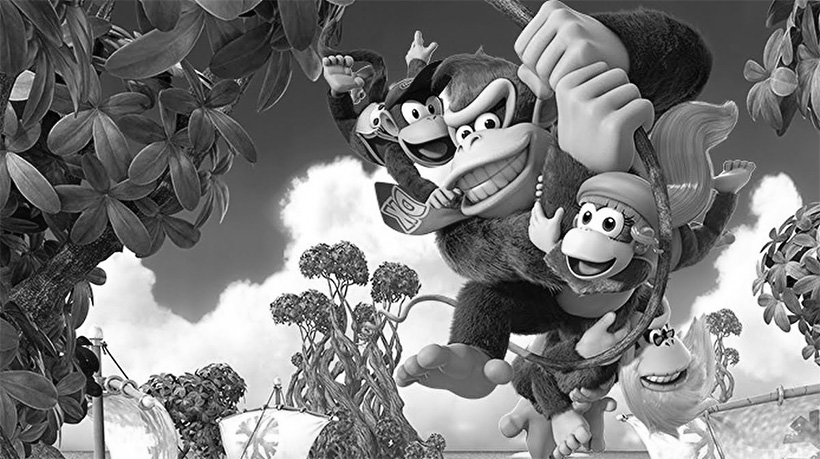

In [7]:
gray_image = img1.convert("L")
gray_image

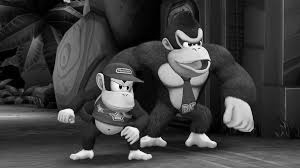

In [8]:
gray_image2 = img2.convert('L')
gray_image2

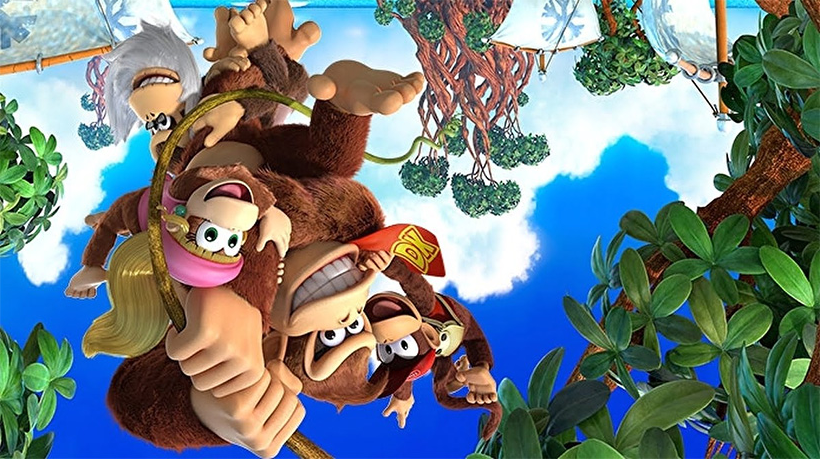

In [9]:
rotated_img = img1.rotate(180)
rotated_img

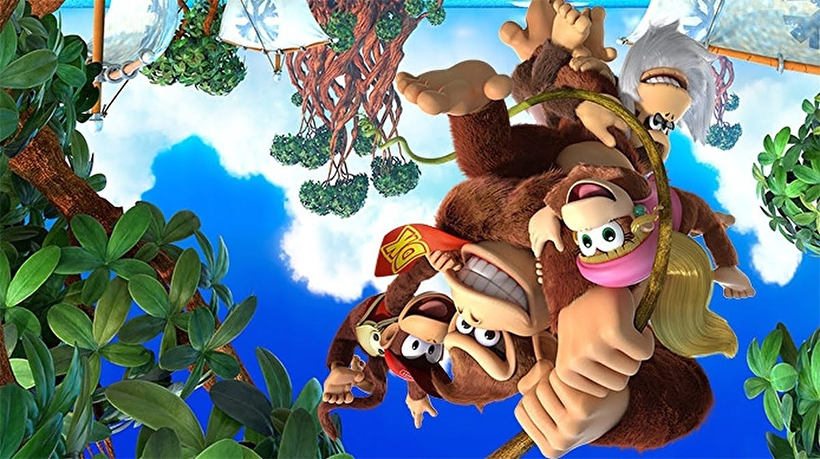

In [10]:
transpose_img = img1.transpose(Image.FLIP_TOP_BOTTOM)    #(Image.FLIP_LEFT_RIGHT)
transpose_img

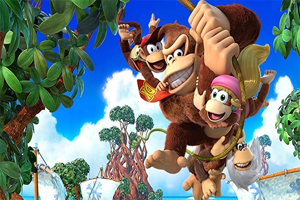

In [11]:
resize_img_small = img1.resize((300, 200))
resize_img_small

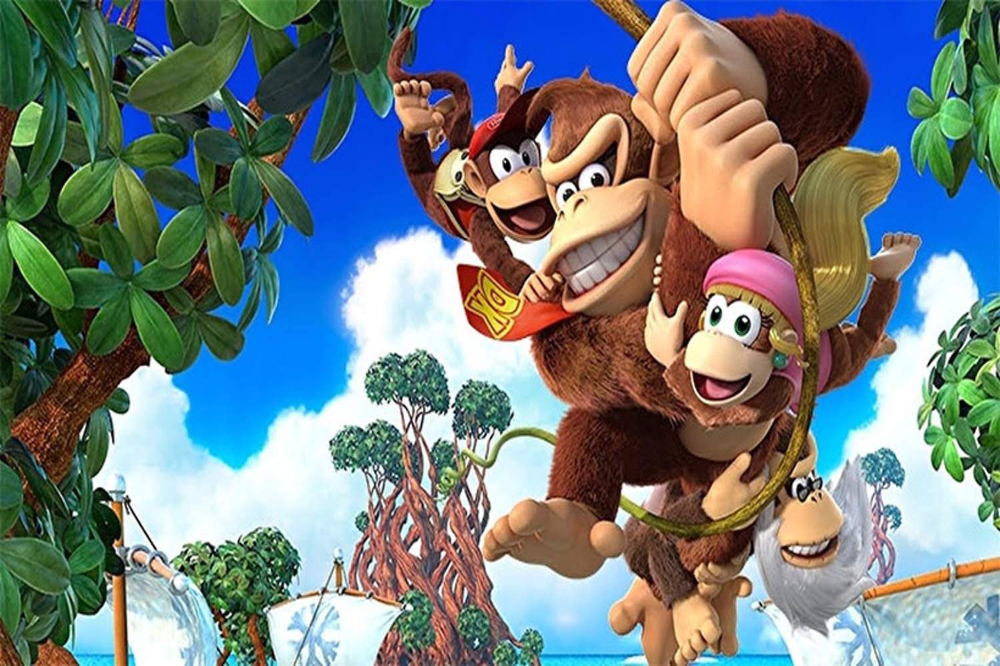

In [12]:
resize_img_big = img1.resize((1500, 1000))
resize_img_big

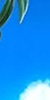

In [13]:
dim = (200,200,250,300) #left, upper, right, low
crop_img = img1.crop(dim)
crop_img

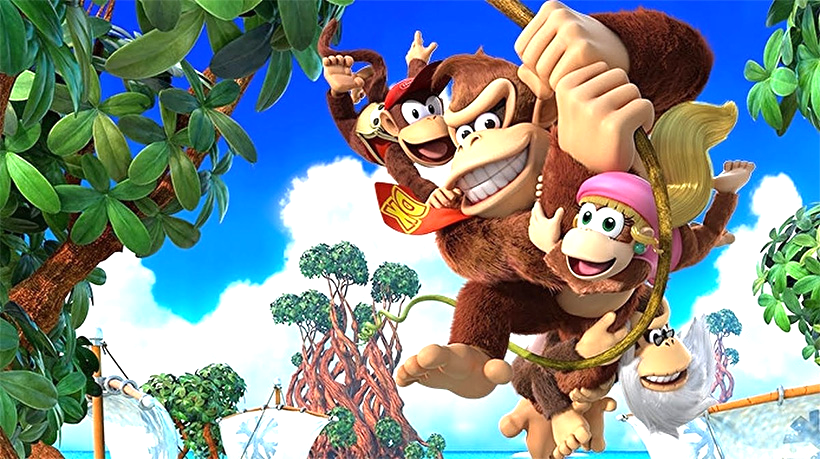

In [14]:
enhancer = ImageEnhance.Brightness(img1)
bright_img = enhancer.enhance(1.2)
bright_img

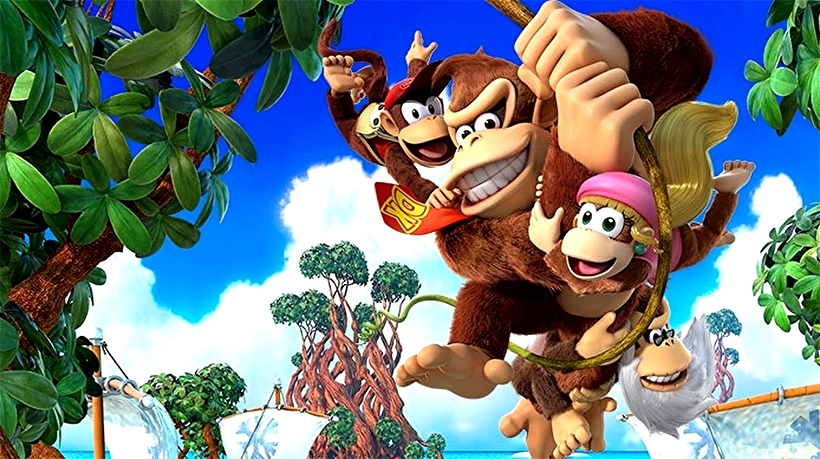

In [15]:
enhancer = ImageEnhance.Contrast(img1)
constrast_img = enhancer.enhance(1.2)
constrast_img

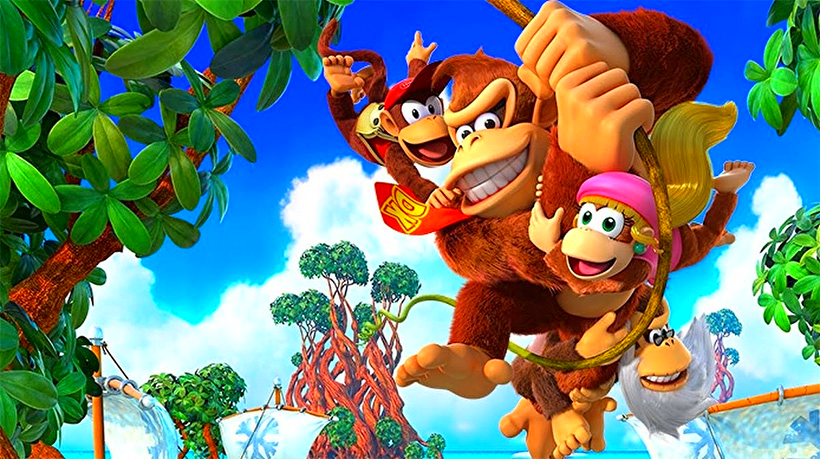

In [16]:
enhancer = ImageEnhance.Color(img1)
saturation_img = enhancer.enhance(2)
saturation_img

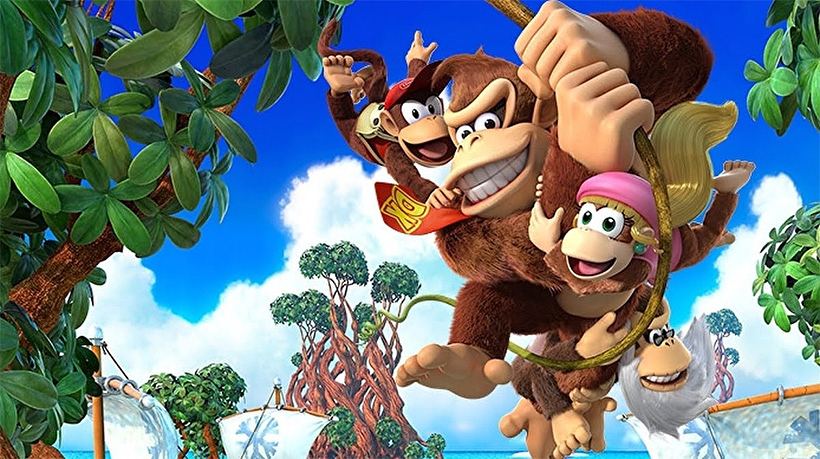

In [17]:
enhancer = ImageEnhance.Sharpness(img1)
sharpness_img = enhancer.enhance(1.2)
sharpness_img

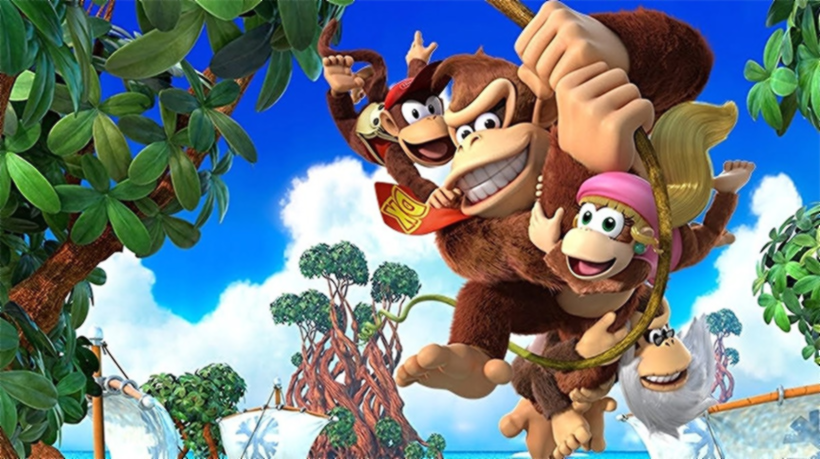

In [18]:
filtro_smooth = img1.filter(ImageFilter.SMOOTH)
filtro_smooth

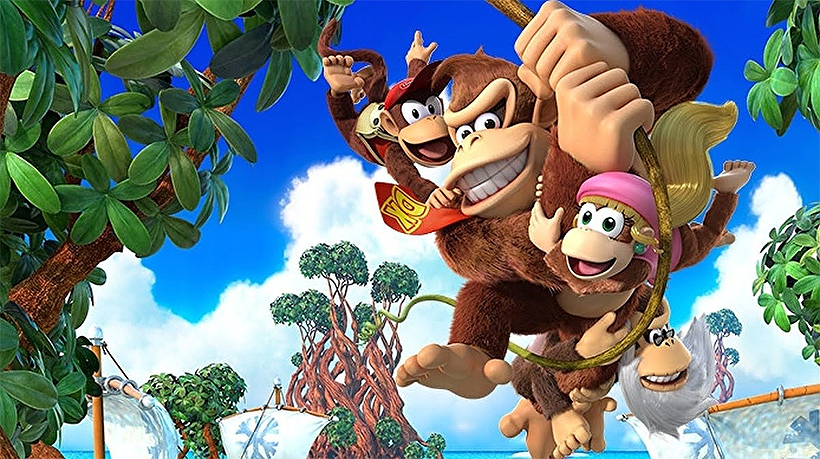

In [19]:
filtro_detail = img1.filter(ImageFilter.DETAIL)
filtro_detail

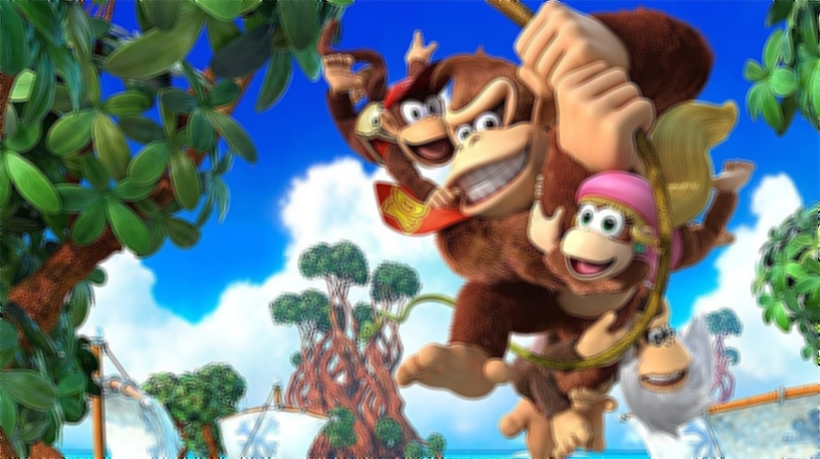

In [20]:
filtro_blur = img1.filter(ImageFilter.BLUR)
filtro_blur

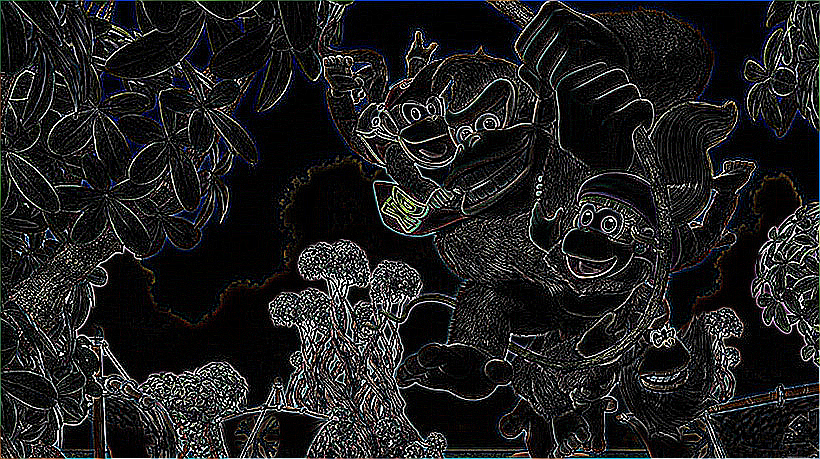

In [21]:
filtro_edge = img1.filter(ImageFilter.FIND_EDGES)
filtro_edge

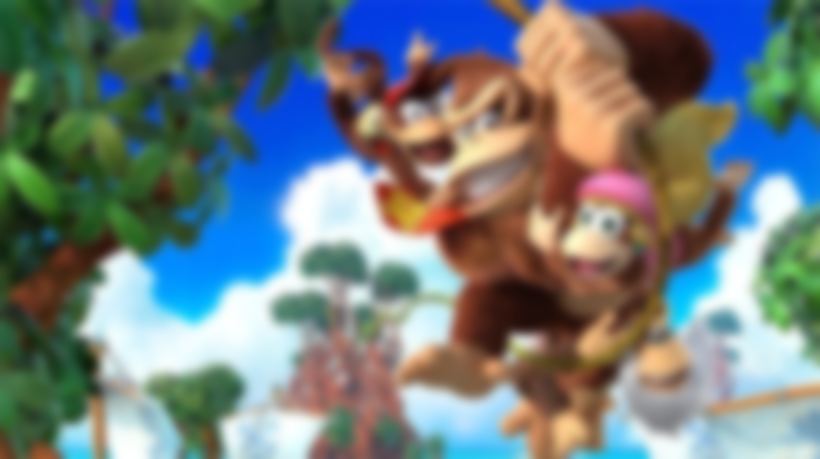

In [22]:
filtro_gaussian_blur = img1.filter(ImageFilter.GaussianBlur(radius=5))
filtro_gaussian_blur

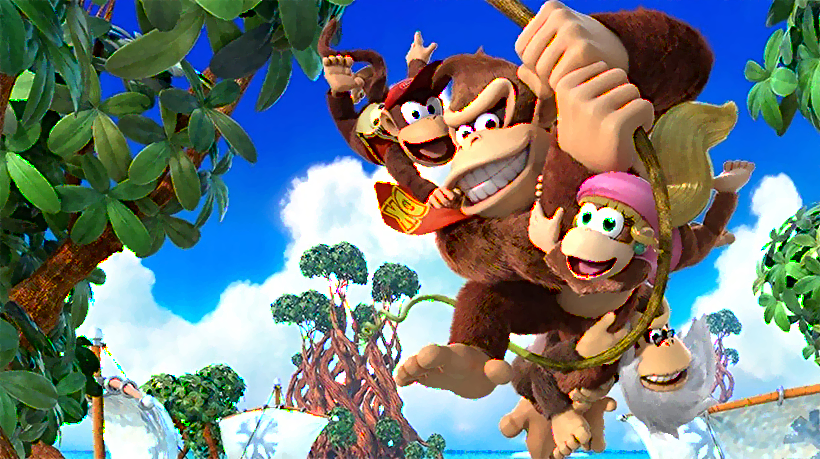

In [23]:
paint_img = img1.filter(ImageFilter.ModeFilter(size=5))
paint_img

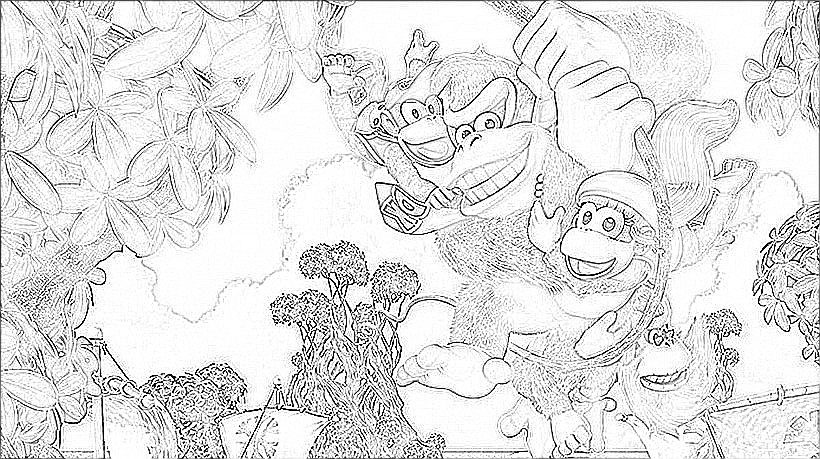

In [24]:
pencil_img = img1.convert('L').filter(ImageFilter.CONTOUR)
pencil_img


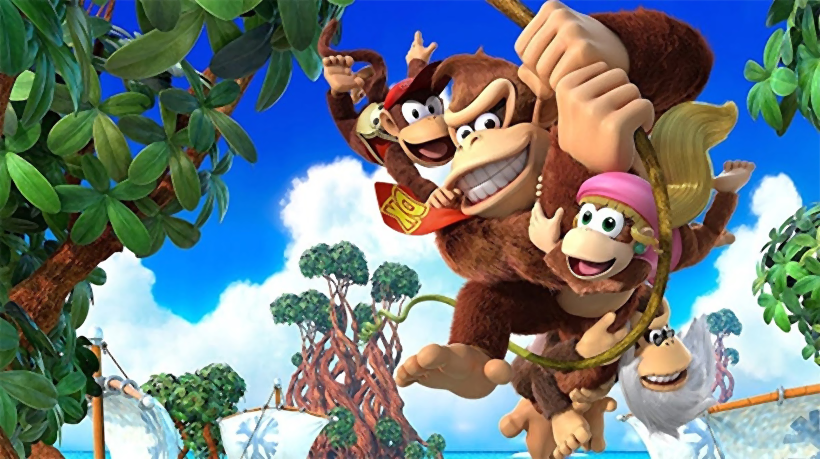

In [25]:
denoised_img = img1.filter(ImageFilter.MedianFilter(size=3))
denoised_img

In [26]:
from PIL import ImageDraw, ImageFont

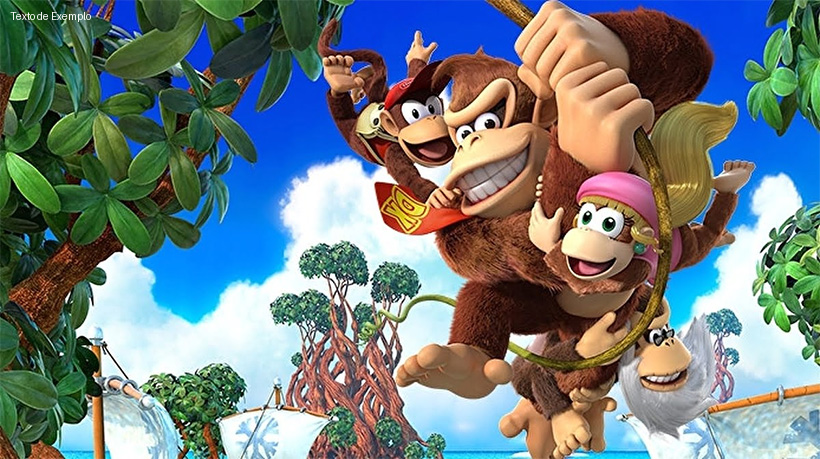

In [28]:
text_img = img1.copy()
draw = ImageDraw.Draw(text_img)
font = ImageFont.load_default()
draw.text((10,10), 'Texto de Exemplo', fill='white', font=font)
text_img

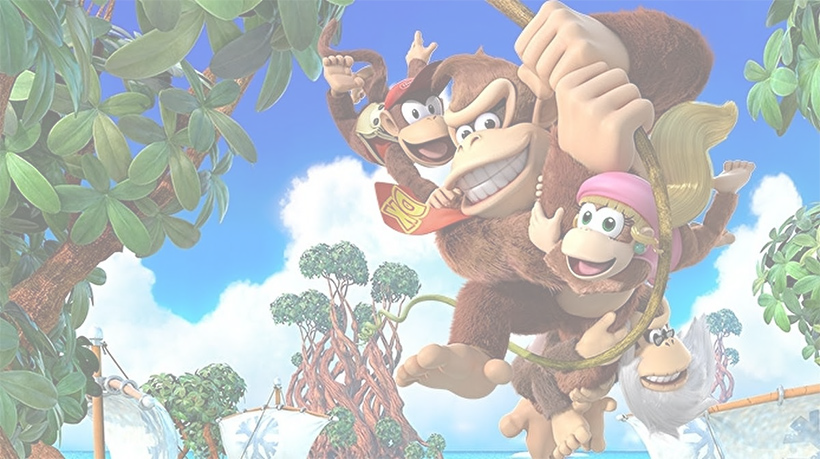

In [29]:
rgba_img = img1.convert('RGBA')
data = rgba_img.getdata()
#Criando uma nova imagem com transparência
new_data = []
for item in data:
    #Mudando a opacidade
    new_data.append((item[0], item[1], item[2], 128)) #50% de transparência
rgba_img.putdata(new_data)
rgba_img

In [30]:
import numpy as np

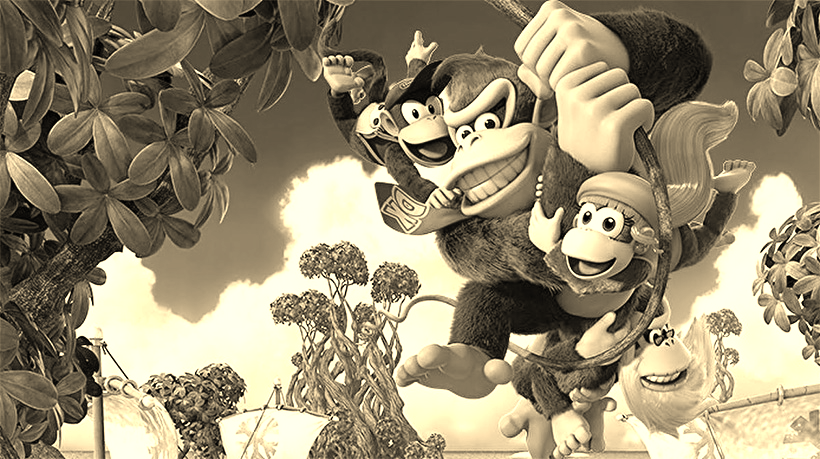

In [31]:
def apply_sepia(img):
    sepia_img = img.convert('RGB')
    width, height = sepia_img.size
    pixels = sepia_img.load()

    for py in range(height):
        for px in range(width):
            r,g,b = pixels[px,py]
            tr = int(0.393 * r + 0.769 * g + 0.189 * b)
            tg = int(0.349 * r + 0.686 * g + 0.168 * b)
            tb = int(0.272 * r + 0.534 * g + 0.131 * b)
            
            tr = min(255, tr)
            tg = min(255, tg)
            tb = min(255, tb)
            
            pixels[px, py] = (tr, tg, tb)
    return sepia_img
sepia_img = apply_sepia(img1)
sepia_img

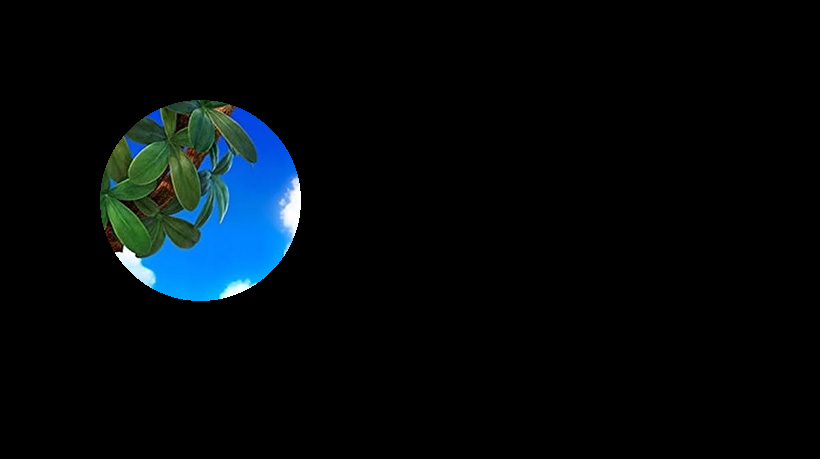

In [33]:
mask = Image.new('L', img1.size, 0)
draw = ImageDraw.Draw(mask)
draw.ellipse((100,100,300,300), fill=255)
masked_img = Image.composite(img1, Image.new('RGB', img1.size, (0,0,0)), mask)
masked_img

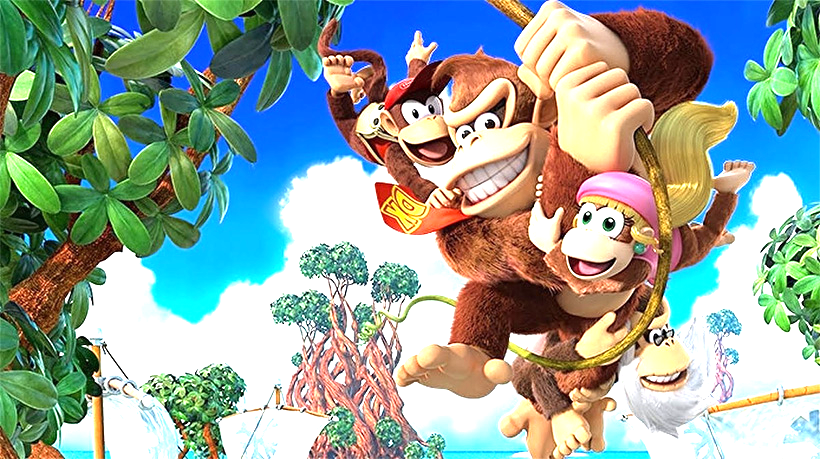

In [34]:
def adjust_exposure(img, factor):
    enhancer = ImageEnhance.Brightness(img)
    return enhancer.enhance(factor)

from PIL import ImageOps

def adjust_gamma(img, gamma):
    return ImageOps.autocontrast(img, cutoff=0)

exposure_img = adjust_exposure(img1, 1.5)
exposure_img

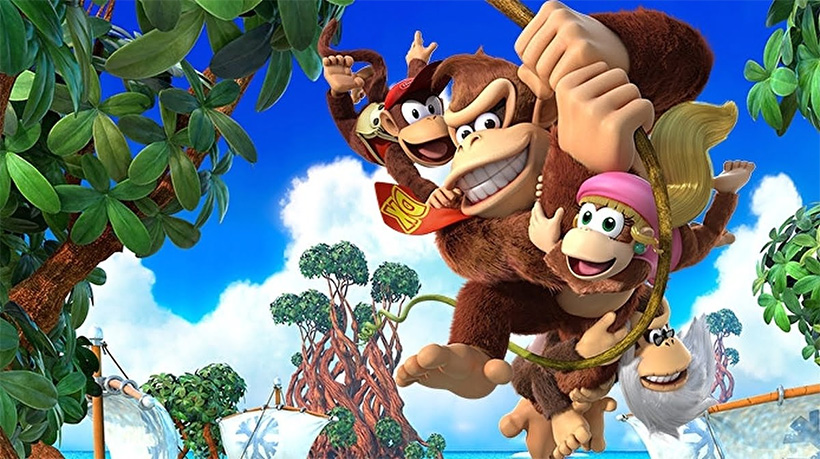

In [35]:
gamma_img = adjust_gamma(img1, 2.0)
gamma_img

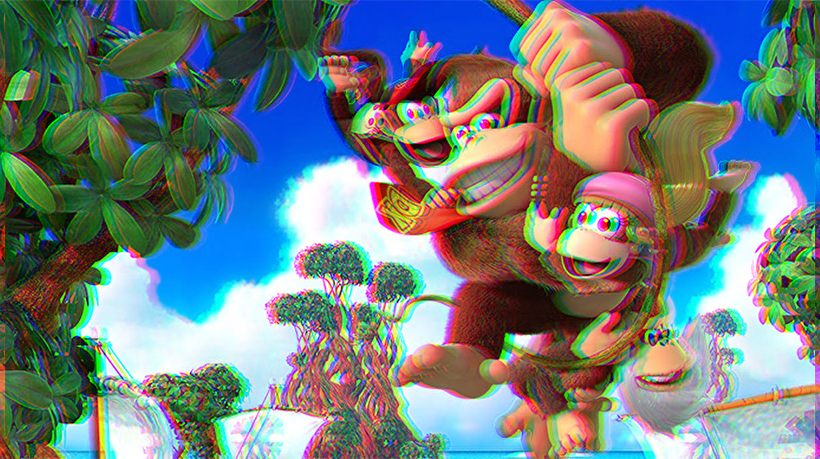

In [38]:
# Imagem 3d
from PIL import ImageChops

left_img = img1.copy()
right_img = img1.copy()

red_channel = ImageChops.offset(left_img.getchannel('R'), 5, 0)
green_channel = ImageChops.offset(right_img.getchannel('G'),-5, 0)

anaglyph_img = Image.merge('RGB', (red_channel, green_channel, left_img.getchannel('B')))
anaglyph_img



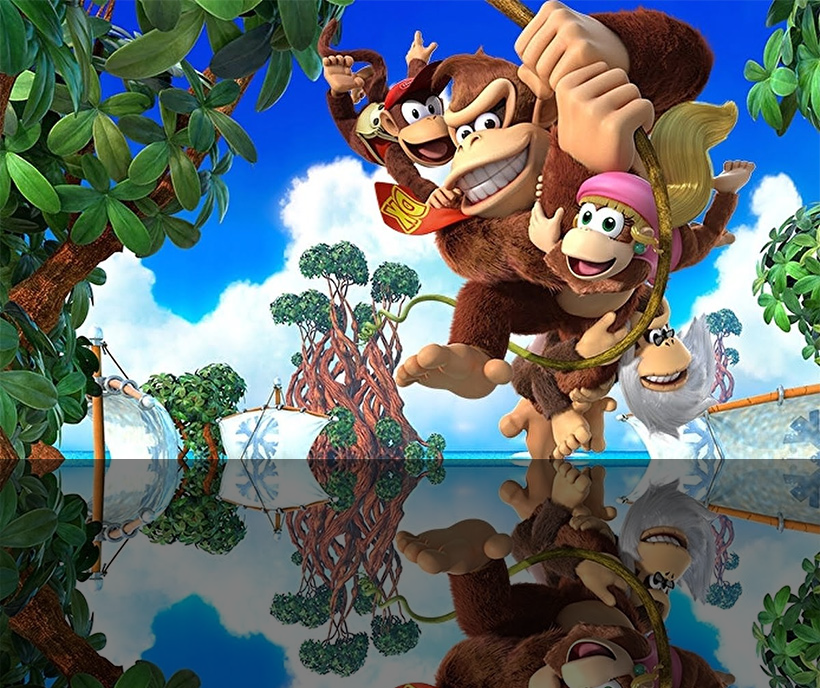

In [40]:
#EFeito de reflexão
def add_reflection(img):
    reflection = img.transpose(Image.FLIP_TOP_BOTTOM)
    reflection = reflection.crop((0,0, img.width, img.height // 2))
    reflection = ImageEnhance.Brightness(reflection).enhance(0.5)
    combined_img = Image.new('RGB', (img.width, img.height + reflection.height))
    combined_img.paste(img, (0,0))
    combined_img.paste(reflection, (0, img.height))
    
    return combined_img

reflection_img = add_reflection(img1)
reflection_img

In [41]:
img3 = Image.open("./img/Mario.jpg")
img4 = Image.open("./img/Mario2.jpg")

In [42]:
import glob

In [45]:
for arquivo in glob.glob("img/*.jpg"):
    im = Image.open(arquivo)
    im